## GEOG0051 Mining Social and Geographic Datasets

### FORMATIVE ASSESSMENT
Name: Joel Goh <br>
Date: 9 February 2024


### 1. Introduction

This analysis explores the relationship between the locations of cafes 2000m around Canada Water station and several measures of street network centrality.

The research question is "which has a greater influence on the location of cafes around Canada Water Station - closeness centrality or betweenness centrality?"

### 2. Description of neighbourhood and dataset.

Canada Water Station is on the Jubilee line. It is south of the River Thames, within Southwark Borough and is part of the Docklands area in southeast London. The area surrounding the station was redeveloped, beginning in the 1980s and is still ongoing, with continued gentrification. It is a mixed-use area with retail and leisure (including a shopping mall), residential, and public amenities such as a library, schools, and a community centre. The neighbourhood has access to green (parks) and blue (canals, lake, river) spaces.

From OpenStreetMaps data, there are 94 cafes (amenities tagged as "cafe") within 2000m from Canada Water station and several stations including Bermondsey, Tower Hill, Aldgate, Aldgate East, Limehouse, and Canary Wharf.

Figure 1 shows the location of cafes and station entrances 2000m around Canada Water Station.

![Figure 1](fig1_points.png)
Figure 1: Location of cafes and station entrances around Canada Water Station



### 3. Analysis
From Figure 1, generally clusters of cafes are observed surrounding underground stations. Closeness and betweenness centrality was calculated for the road network. Figures 2 and 3 visualise closeness centrality and betweenness centrality respectively. Streets in warmer colours indicate higher centrality while cooler colours indicate lower centrality.

![Figure 2](fig2_closeness.png)
Figure 2: Closeness centrality for road network (walking) around Canada Water Station

![Figure 3](fig3_betweenness.png)
Figure 3: Betweenness centrality for road network (walking) around Canada Water Station




### 4. Discussion

From Figure 2, roads with the highest closeness centrality are north and west of Canada Water Station including the areas surrounding the A200 Road, Jamaica Road, Rotherhithe Tunnel and Lower Road. From Figure 3, roads with the highest betweenness centrality are the Rotherhithe Tunnel followed by the areas near Surrey Quays Road and Canada Estate. Some roads with high closeness centrality also have high betweenness centrality.

From visual inspection, both closeness and betweenness centrality are correlated with the locations of cafes. However, closeness centrality appears to have a greater influence on the locations of cafes around Canada Water Station. This may be because the Rotherhithe Tunnel that has the highest betweenness centrality at this scale of analysis is not pedestrian-friendly.

Based on this initital analysis, cafes and shops can be placed in areas surrounding underground stations. Specifically for Canada Water station, potential optimal locations include the road network and surrounding areas between Canada Water Station and Bermondsey Station that have high closeness centrality and moderate betweenness centrality.

It should be noted that because the scale of analysis is 2000m around Canada Water Station, areas with clusters of cafes around other underground stations appear to have generally lower centrality due to the "buffer effect" which causes biasness. Another limitation is that the OpenStreetMap data used may not have all cafe point locations.

More detailed analysis examining other types of amenities and businesses at different scales should be conducted to obtain further insights.

### 5. Python Code

In [ ]:
# Convert to Markdown file.
!jupyter nbconvert --to markdown "Formative Assessment v1.ipynb"

In [11]:
# Import libraries needed.
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import osmnx as ox
import networkx as nx
import matplotlib.cm as cm
import matplotlib.colors as colors
import contextily as ctx



In [3]:
# Download and plot street network graph 2000m around Canada Water Station.
G = ox.graph_from_address('Canada Water Station, London', dist = 2000, network_type = 'walk')


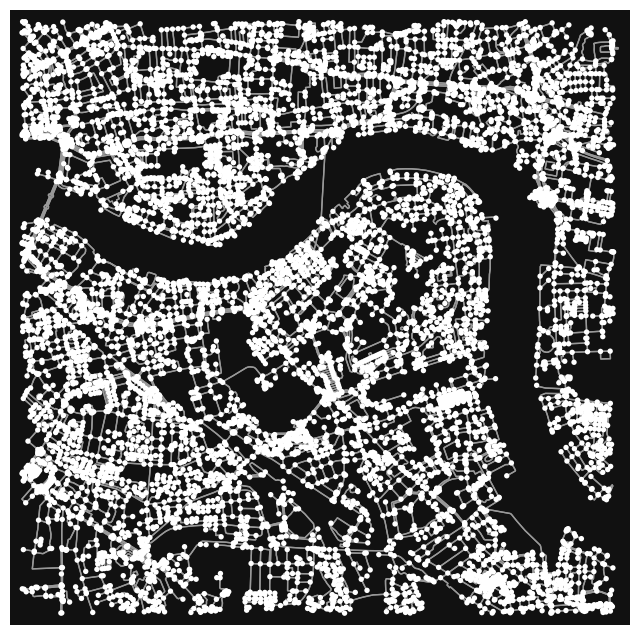

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [4]:
# Plot street network graph
ox.plot_graph(G)

<Axes: >

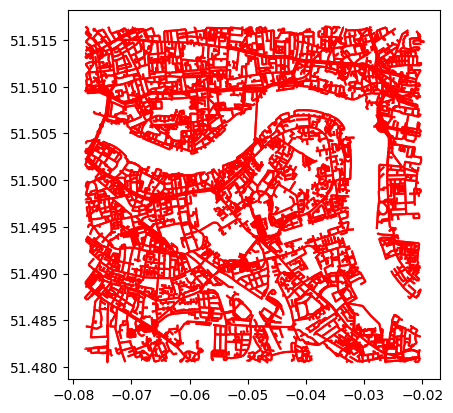

In [99]:
# Convert the graph G to GeoDataFrames
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

# Display with basemap
Base_map = gdf_edges.plot(color = 'red')
Base_map


In [6]:
# Set multigraph as digraph
DG = ox.get_digraph(G)

In [7]:
# Convert graph to a line graph and calculate closeness centrality
# Warning took 13 minutes to run.
edge_cc = nx.closeness_centrality(nx.line_graph(DG))

In [8]:
# Set the centrality measure of each node as an edge attribute of the graph network object.
nx.set_edge_attributes(DG, edge_cc, 'cc')
G1 = nx.MultiGraph(DG)

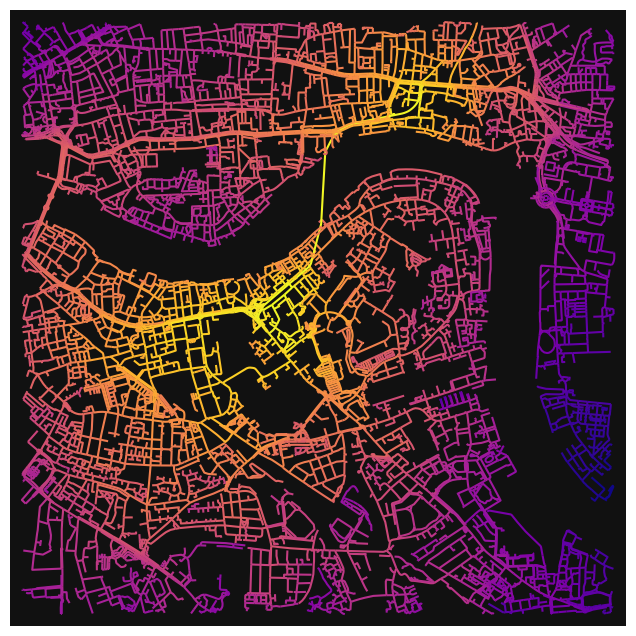

In [24]:
# Plot closeness centrality for edges in the line graph.
node_colours = ox.plot.get_edge_colors_by_attr(G1, 'cc', cmap = 'plasma')
fig, ax = ox.plot_graph(G1, node_size=0, node_color='w', node_edgecolor='gray', node_zorder=2,
                        edge_color=node_colours, edge_linewidth=1.5, edge_alpha=1)

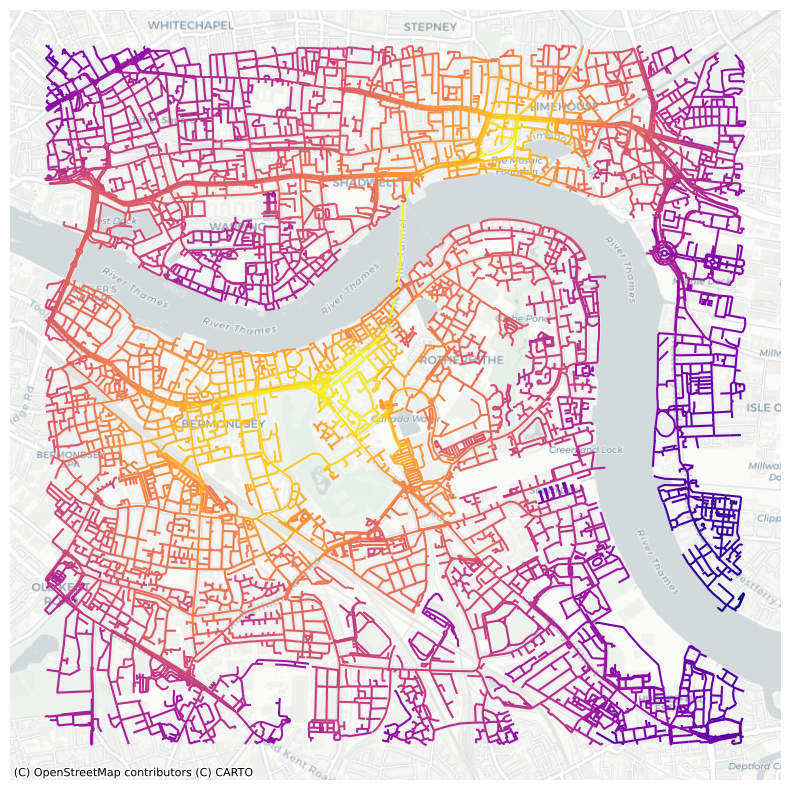

In [12]:
# Convert closeness centrality graph to geopandas dataframe.
gdf_edges_cc = ox.graph_to_gdfs(G1, nodes = False, fill_edge_geometry = True)

# Set CRS to 3857.
gdf_edges_cc = gdf_edges_cc.to_crs(epsg = 3857)

# Plot edges according to degree centrality.
ax = gdf_edges_cc.plot('cc', cmap = 'plasma', figsize = (10, 10))

# Add a basemap using contextily
import contextily as ctx
ctx.add_basemap(ax, source = ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.show()




In [13]:
# Convert graph to a line graph and calculate betweeness centrality
# Warning: Took 73 minutes to run.
edge_bc = nx.betweenness_centrality(nx.line_graph(DG))

In [25]:
# Set the centrality measure of each node as an edge attribute of the graph network object.
nx.set_edge_attributes(DG, edge_bc, 'bc')
G2 = nx.MultiGraph(DG)

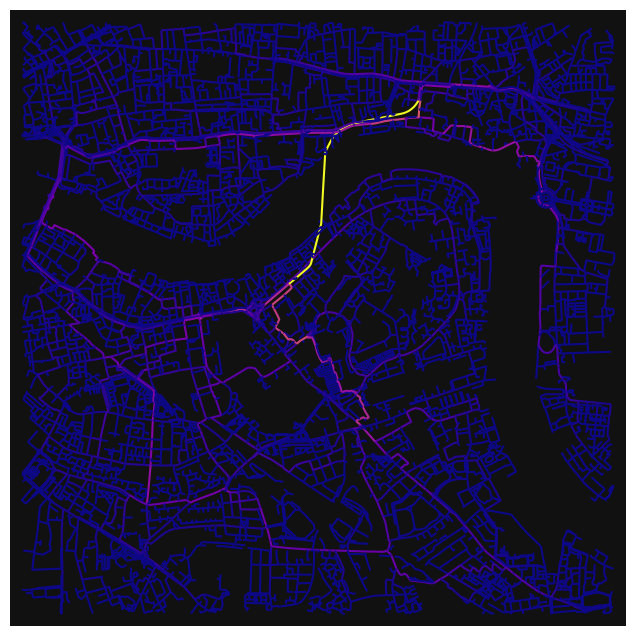

In [26]:
# Plot betweenness centrality for edges in the line graph.
node_colours = ox.plot.get_edge_colors_by_attr(G2, 'bc', cmap = 'plasma')
fig, ax = ox.plot_graph(G2, node_size=0, node_color='w', node_edgecolor='gray', node_zorder=2,
                        edge_color=node_colours, edge_linewidth=1.5, edge_alpha=1)

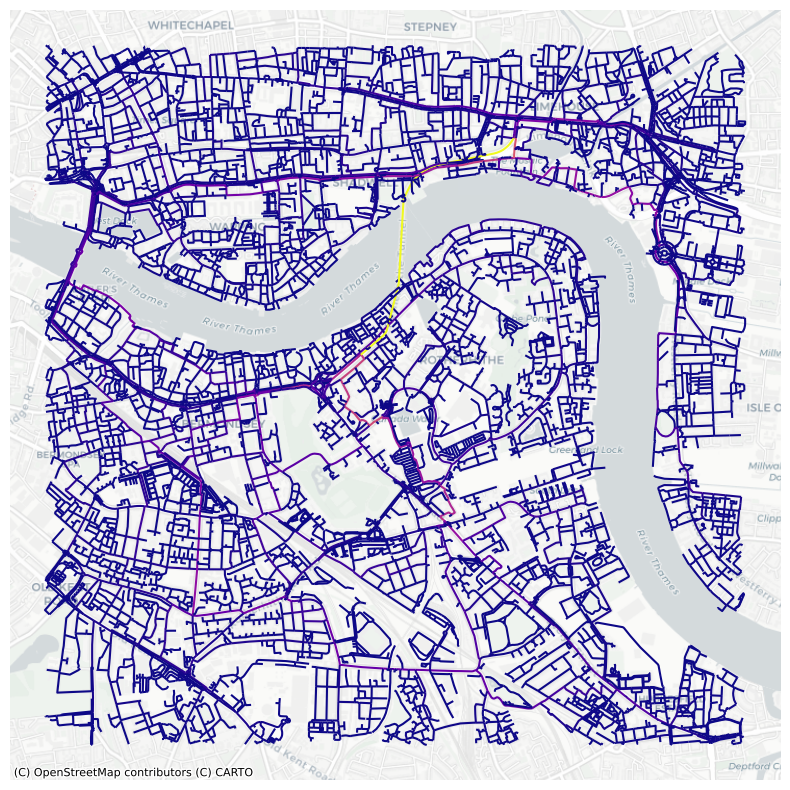

In [43]:
# Convert betweenness centrality graph to geopandas dataframe.
gdf_edges_bc = ox.graph_to_gdfs(G2, nodes = False, fill_edge_geometry = True)

# Set CRS to 3857.
gdf_edges_bc = gdf_edges_bc.to_crs(epsg = 3857)

# Plot edges according to degree centrality.
ax = gdf_edges_bc.plot('bc', cmap = 'plasma', figsize = (10, 10))

# Add a basemap using contextily
ctx.add_basemap(ax, source = ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.show()

In [57]:
# Get OpenStreetMap cafe point data.
cafe_tags = {'amenity': 'cafe'}
cafes_geom = ox.geometries.geometries_from_address('Canada Water Station, London', cafe_tags, dist = 2000)
cafes_geom = cafes_geom.to_crs(epsg = 3857)

C:\Users\JoelGohTzeWen\AppData\Local\Temp\ipykernel_31664\128528905.py:3: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  cafes_geom = ox.geometries.geometries_from_address('Canada Water Station, London', cafe_tags, dist = 2000)


In [58]:
cafes_points = cafes_geom[cafes_geom.geometry.type == 'Point']

In [85]:
# Inspect cafe points data.
cafes_points

addr:city   addr:housename addr:housenumber  \
element_type osmid                                                     
node         249314702      London  Turks Head Cafe                1   
             279249388      London              NaN               31   
             286493172         NaN              NaN              NaN   
             364688814      London              NaN              138   
             420293965      London              NaN              217   
...                            ...              ...              ...   
             10674942927    London              NaN          819-821   
             10745161076       NaN              NaN              NaN   
             10997382493       NaN              NaN              NaN   
             11070139981       NaN              NaN              NaN   
             11096912605    London              NaN               4b   

                         addr:postcode          addr:street amenity  \
element_type osmid                                                    
node         249314702         E1W 2PA           Green Bank    cafe   
             279249388          E1 2DL        Nelson Street    cafe   
             286493172             NaN                  NaN    cafe   
             364688814         E1W 3PA  Wapping High Street    cafe   
             420293965        SE15 1NS        Ilderton Road    cafe   
...                                ...                  ...     ...   
             10674942927       E14 7HG      Commercial Road    cafe   
             10745161076           NaN                  NaN    cafe   
             10997382493           NaN                  NaN    cafe   
             11070139981           NaN                  NaN    cafe   
             11096912605       E1W 2AA          Vaughan Way    cafe   

                                                                    cuisine  \
element_type osmid                                                            
node         249314702                                        international   
             279249388                                                  NaN   
             286493172                                                  NaN   
             364688814                                          coffee_shop   
             420293965                                                  NaN   
...                                                                     ...   
             10674942927  coffee_shop;burger;pasta;breakfast;lunch;diner...   
             10745161076                                        coffee_shop   
             10997382493                                         bubble_tea   
             11070139981                                        coffee_shop   
             11096912605                                                NaN   

                          fhrs:id                    name  \
element_type osmid                                          
node         249314702      79346        Turk's Head Cafe   
             279249388      83720          Cafe Donatella   
             286493172        NaN            Archway Cafe   
             364688814        NaN          Urban Baristas   
             420293965     364390           Ilderton Cafe   
...                           ...                     ...   
             10674942927  1589896          Beans & Beyond   
             10745161076      NaN               Starbucks   
             10997382493      NaN  CoCo Fresh Tea & Juice   
             11070139981      NaN                     NaN   
             11096912605      NaN           Urban Barista   

                                                              opening_hours  \
element_type osmid                                                            
node         249314702    Mo 16:00-22:00; Tu-Fr 18:00-23:00; Sa 09:00-23:00   
             279249388                                                  NaN   
             286493172    

In [73]:
# Get OpenStreetMap tube station point data.
station_tags = {'railway': 'subway_entrance'}
stations_geom = ox.geometries.geometries_from_address('Canada Water Station, London', station_tags, dist = 2000)
stations_geom = stations_geom.to_crs(epsg = 3857)

C:\Users\JoelGohTzeWen\AppData\Local\Temp\ipykernel_31664\2127756433.py:3: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  stations_geom = ox.geometries.geometries_from_address('Canada Water Station, London', station_tags, dist = 2000)


In [74]:
stations_points = stations_geom[stations_geom.geometry.type == 'Point']

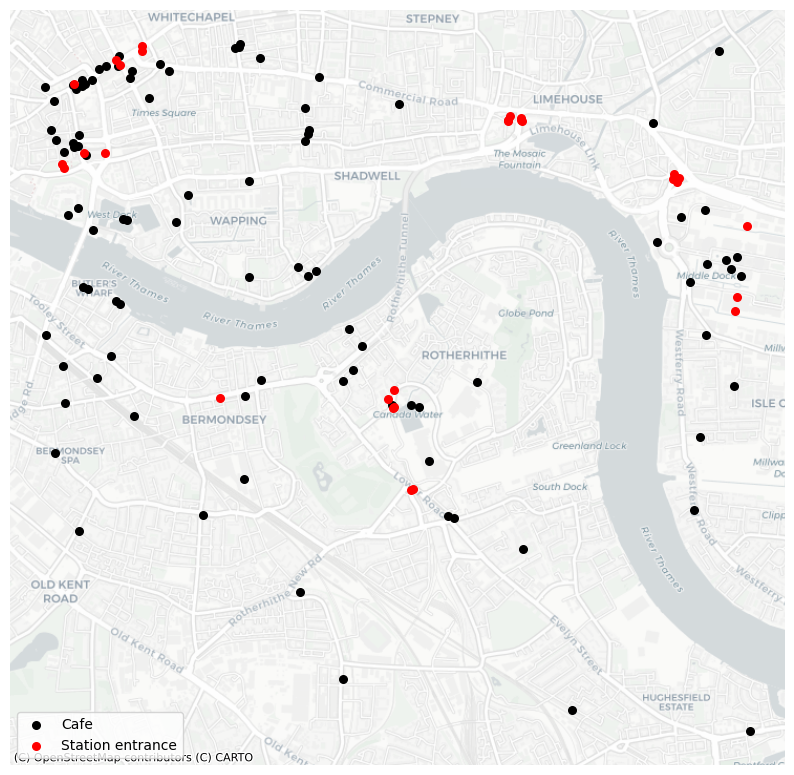

In [95]:
# Visualise cafe and station entrance points data.
fig,ax = plt.subplots(figsize=(10,10))
cafes_points.plot(ax=ax,color='black', markersize=30, label = 'Cafe')
stations_points.plot(ax=ax,color='red',markersize=30, label = 'Station entrance')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.legend()
plt.show()
fig.savefig('fig1_points.png', dpi=400)

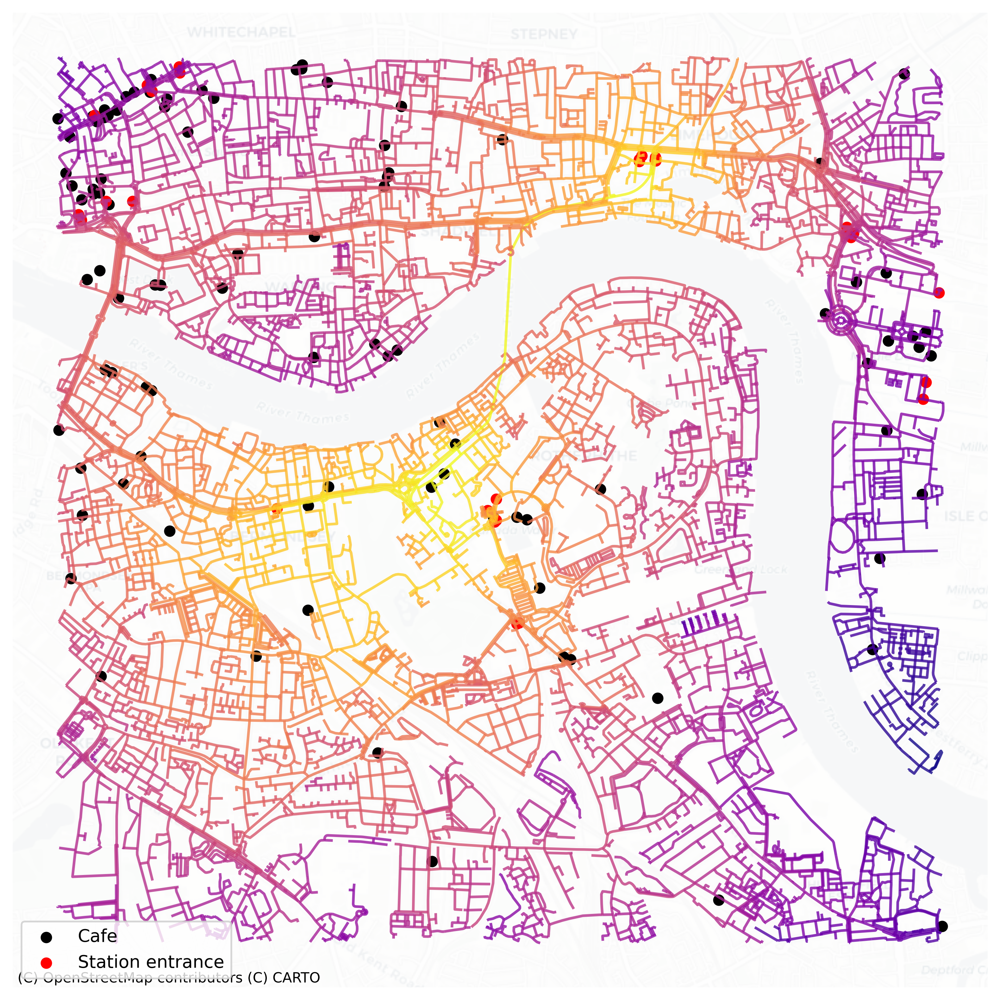

In [98]:
# Plot edges according to closeness centrality.
fig, ax = plt.subplots(figsize = (10, 10), dpi = 400)

gdf_edges_cc.plot(
    'cc', cmap = 'plasma', alpha = 0.8, ax = ax)
cafes_points.plot(ax=ax,color='black', markersize=30, label = 'Cafe')
stations_points.plot(ax=ax,color='red',markersize=30, label = 'Station entrance')
# Add a basemap using contextily
ctx.add_basemap(ax, source = ctx.providers.CartoDB.Positron, alpha = 0.2)
plt.axis('off')
plt.legend()
plt.show()
fig.savefig("fig2_closeness.png", dpi = 400)

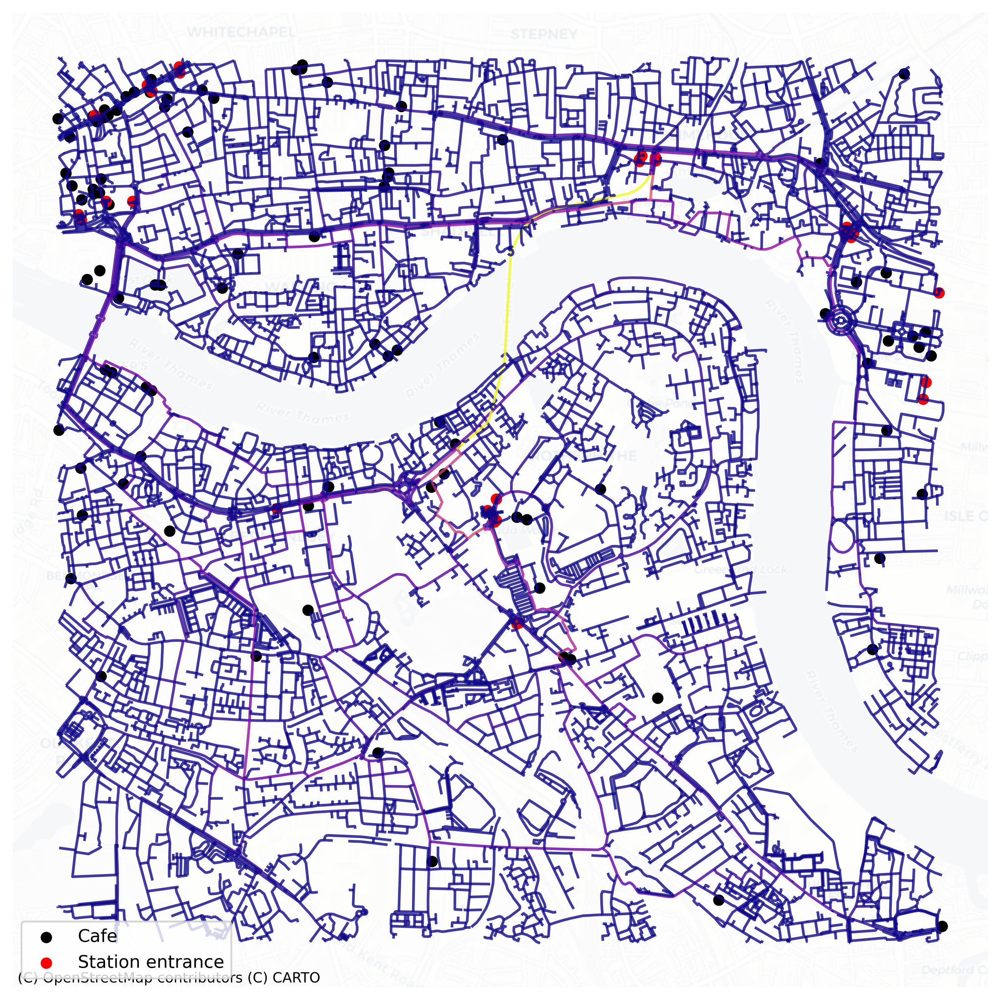

In [97]:
# Plot edges according to betweenness centrality.
fig, ax = plt.subplots(figsize = (10, 10), dpi = 400)

gdf_edges_bc.plot(
    'bc', cmap = 'plasma', alpha = 0.8, ax = ax)
cafes_points.plot(ax=ax,color='black', markersize=30, label = 'Cafe')
stations_points.plot(ax=ax,color='red',markersize=30, label = 'Station entrance')
# Add a basemap using contextily
ctx.add_basemap(ax, source = ctx.providers.CartoDB.Positron, alpha = 0.2)
plt.axis('off')
plt.legend()
plt.show()
fig.savefig('fig3_betweenness.png', dpi=400)

In [91]:
# Get the geometries of places/buildings around canada Water station.
tags_buildings = tags={'amenity': True, 'highway':True, 'landuse':True, 'building':True, 'waterway': True, 'railway': True}
all_geom=ox.geometries.geometries_from_address('Canada Water Station, London', tags_buildings, dist=2000)
all_geom = all_geom.to_crs(epsg=3857)

C:\Users\JoelGohTzeWen\AppData\Local\Temp\ipykernel_31664\95609584.py:3: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  all_geom=ox.geometries.geometries_from_address('Canada Water Station, London', tags_buildings, dist=2000)


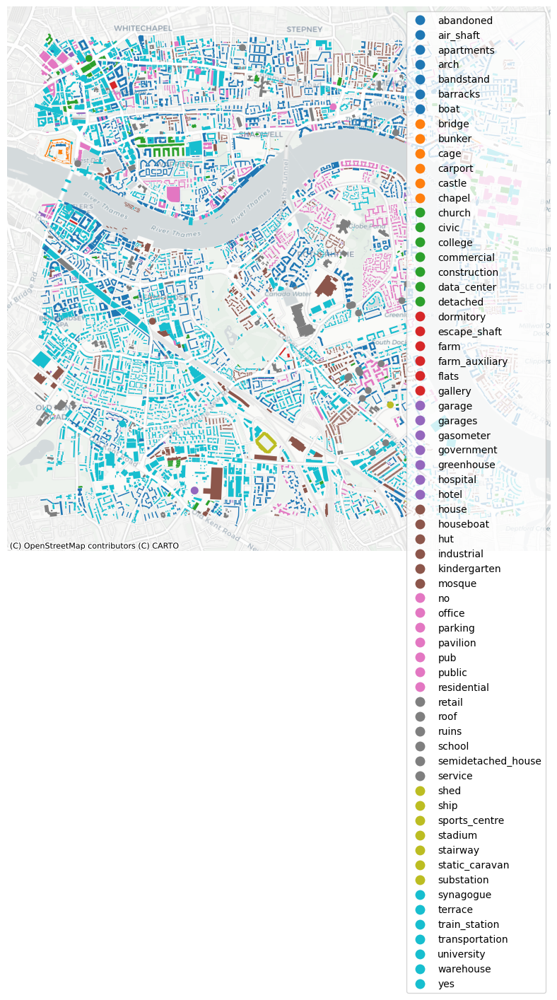

In [92]:
# Inspect / explore data.
# Map buildings around Canada Water Station (just for inspection/exploration).
fig,ax = plt.subplots(figsize=(10,10))
all_geom[all_geom['building'].notna()].plot('building',
                                            ax=ax,
                                            categorical=True,
                                            legend=True)
import contextily as ctx
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.show()